In [ ]:
#The aim of this project was to play around with geopandas.
#This dataset was taken from NCOneMap, and can be found under Census tracts.
#It depicts the 2010 Census in North carolina.
#I becamin interested in the population from this census, as it cool to see how my local area has grown.

In [2]:
#Importing Packages
import geopandas as gpd
import matplotlib.pyplot as plt
import folium

In [3]:
#Reading in the data as Geopandas Dataframes
urban = gpd.read_file(r'C:\Users\kenny\Documents\Python Scripts\2010_Census_Urban_Areas\2010_Census_Urban_Areas.shp')
pop = gpd.read_file(r'C:\Users\kenny\Documents\Python Scripts\2010_Census\2010_Census_Tracts.shp')


,objectid,uace10,geoid10,name10,namelsad10,lsad10,mtfcc10,uatyp10,funcstat10,aland10,awater10,intptlat10,intptlon10,st_areasha,st_perimet,geometry
0,1,00658,00658,"Ahoskie, NC","Ahoskie, NC Urban Cluster",76,G3500,C,S,7551326,0,+36.2878653,-076.9832823,7.551814e+06,3.130767e+04,"MULTIPOLYGON (((791123.051 281714.597, 791120...."
1,2,00982,00982,"Albemarle, NC","Albemarle, NC Urban Cluster",76,G3500,C,S,44414396,63396,+35.3753217,-080.1893177,4.446687e+07,8.108008e+04,"MULTIPOLYGON (((497433.661 176285.942, 497465...."
2,3,02965,02965,"Archer Lodge--Clayton, NC","Archer Lodge--Clayton, NC Urban Cluster",76,G3500,C,S,52581462,265273,+35.6685869,-078.3657386,5.283612e+07,6.460482e+04,"POLYGON ((664064.250 208118.102, 664064.904 20..."
3,4,03331,03331,"Asheboro, NC","Asheboro, NC Urban Cluster",76,G3500,C,S,85286266,197576,+35.7312709,-079.8042624,8.546798e+07,1.674562e+05,"MULTIPOLYGON (((531388.737 231025.017, 531430...."
4,5,03358,03358,"Asheville, NC","Asheville, NC Urbanized Area",75,G3500,U,S,686027223,6297443,+35.5364279,-082.6655698,6.921634e+08,1.069227e+06,"MULTIPOLYGON (((268189.741 204929.480, 268197...."


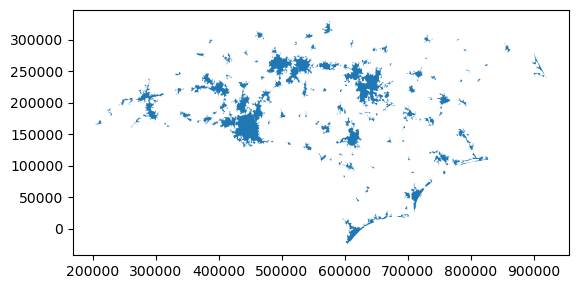

In [119]:
#Reading in the Data from the Urban Areas and also plotting them to visualize the data
urban.plot()
urban.head()


,objectid,geoid10,total_pop,st_areasha,st_perimet,geometry
0,1,37153970100,3676,2.483285e+08,82854.221563,"POLYGON ((557817.713 138233.553, 557785.098 13..."
1,2,37153970200,4930,4.654568e+08,127918.576240,"POLYGON ((544247.059 158155.577, 544271.244 15..."
2,3,37153970800,5340,1.420812e+08,53616.058881,"POLYGON ((539401.982 122961.502, 539399.777 12..."
3,4,37153970900,5236,2.338429e+07,23357.789549,"POLYGON ((539401.982 122961.502, 539402.004 12..."
4,5,37153971000,4174,4.941027e+07,35285.453492,"POLYGON ((546503.368 127106.587, 546502.605 12..."


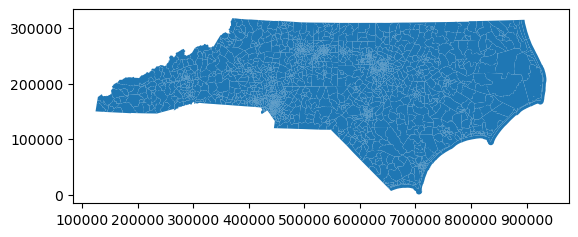

In [120]:
#The same is being done for the population dataset
pop.plot()
pop.head()

In [6]:
#Displaying Coordinate Systems
pop.crs

<Derived Projected CRS: EPSG:32119>
Name: NAD83 / North Carolina
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: United States (USA) - North Carolina - counties of Alamance; Alexander; Alleghany; Anson; Ashe; Avery; Beaufort; Bertie; Bladen; Brunswick; Buncombe; Burke; Cabarrus; Caldwell; Camden; Carteret; Caswell; Catawba; Chatham; Cherokee; Chowan; Clay; Cleveland; Columbus; Craven; Cumberland; Currituck; Dare; Davidson; Davie; Duplin; Durham; Edgecombe; Forsyth; Franklin; Gaston; Gates; Graham; Granville; Greene; Guilford; Halifax; Harnett; Haywood; Henderson; Hertford; Hoke; Hyde; Iredell; Jackson; Johnston; Jones; Lee; Lenoir; Lincoln; Macon; Madison; Martin; McDowell; Mecklenburg; Mitchell; Montgomery; Moore; Nash; New Hanover; Northampton; Onslow; Orange; Pamlico; Pasquotank; Pender; Perquimans; Person; Pitt; Polk; Randolph; Richmond; Robeson; Rockingham; Rowan; Rutherford; Sampson; Scotland; Stanly; Stokes; Surry; Swain; Trans

In [7]:
#Displaying Coordinate Systems
urban.crs

<Derived Projected CRS: EPSG:32119>
Name: NAD83 / North Carolina
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: United States (USA) - North Carolina - counties of Alamance; Alexander; Alleghany; Anson; Ashe; Avery; Beaufort; Bertie; Bladen; Brunswick; Buncombe; Burke; Cabarrus; Caldwell; Camden; Carteret; Caswell; Catawba; Chatham; Cherokee; Chowan; Clay; Cleveland; Columbus; Craven; Cumberland; Currituck; Dare; Davidson; Davie; Duplin; Durham; Edgecombe; Forsyth; Franklin; Gaston; Gates; Graham; Granville; Greene; Guilford; Halifax; Harnett; Haywood; Henderson; Hertford; Hoke; Hyde; Iredell; Jackson; Johnston; Jones; Lee; Lenoir; Lincoln; Macon; Madison; Martin; McDowell; Mecklenburg; Mitchell; Montgomery; Moore; Nash; New Hanover; Northampton; Onslow; Orange; Pamlico; Pasquotank; Pender; Perquimans; Person; Pitt; Polk; Randolph; Richmond; Robeson; Rockingham; Rowan; Rutherford; Sampson; Scotland; Stanly; Stokes; Surry; Swain; Trans

In [9]:
# Double-Checking
urban.crs == pop.crs

True

In [30]:
# Intersecting Urban areas with 2010 pop numbers
pop_density = gpd.overlay(urban,pop,how='intersection')
pop_density.explore()

In [116]:
#Creating a new dataset with just Greensboro
urbanpop = pop_density[pop_desnity['name10'] == 'Greensboro, NC']

In [117]:
#Cleaning up the columns that I want to display on my plot
column_name = {'name10': 'City', 'total_pop': 'Population'}
urbanpop = urbanpop.rename(columns = column_name)

In [118]:
#Creating the plot and visulaizing the data on map form

m = urbanpop.explore(column='Population',
                     cmap='YlGn',
                     scheme='EqualInterval',
                     k=7,
                     tooltip=('City','Population'))
m


In [ ]:
#This was the population back in 2010. I Hope to find the Census Data from a newer census, and visualize how the area has changed over time.